In [24]:
#script for exploratory data analysis (EDA)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import LabelEncoder
from preprocess_data import load_data

In [25]:

database_numeric, info_dict = load_data()

# count and print the nans in each column
print('NANS IN EACH COLUMN')
print(database_numeric.isnull().sum().to_string())


NANS IN EACH COLUMN
0
WHO 2016                   0
WHO 2022                   0
ICC 2022                   0
ELN 2017                   0
ELN 2022                   0
AGE                       30
Allogeneic HSCT            0
Autologous HSCT            0
Overall survival          30
TIME TO CR               304
TIME TO HSCT             749
TIME TO RELAPSE          958
STATUS AT HSCT             0
TIME FROM CR1 TO HSCT    907
FAMILY DONOR             314
RESPONSE TO INDUCTION      0
STATUS_OS                 30
STATUS_EFS                30
EFS EVENT                  0
TIME TO EFS               31
RFS STATUS               300
TIME TO RFS              304
HB                        51
PLT                       51
WBC                       50
LDH                       75
SEX                       30
BM BLASTS                155
ECOG                     206
PB BLASTS                165
SPLENOMEGALY             309
complex                   30
inv3_t3_3                152
t_9_22               

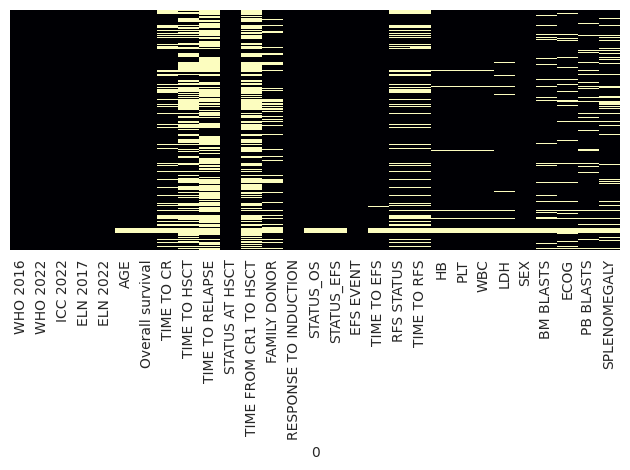

In [26]:

nongenetic_df = database_numeric.copy()
nongenetic_df = nongenetic_df.drop(info_dict['genetic_vars'], axis=1)




sns.heatmap(nongenetic_df.isnull(),
            yticklabels=False,
            cbar=False,
            cmap='magma')
plt.tight_layout()
plt.show()

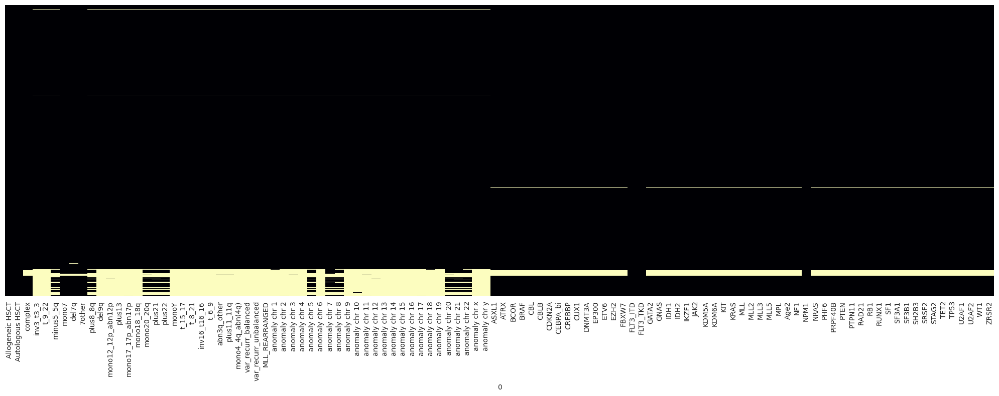

In [27]:
# now with genetic variables
genetic_df = database_numeric.copy()
genetic_df = genetic_df.loc[:, info_dict['genetic_vars']]

fig = plt.figure(figsize=(20, 8))
sns.heatmap(genetic_df.isnull(),
            yticklabels=False,
            cbar=False,
            cmap='magma')
plt.tight_layout()
plt.show()

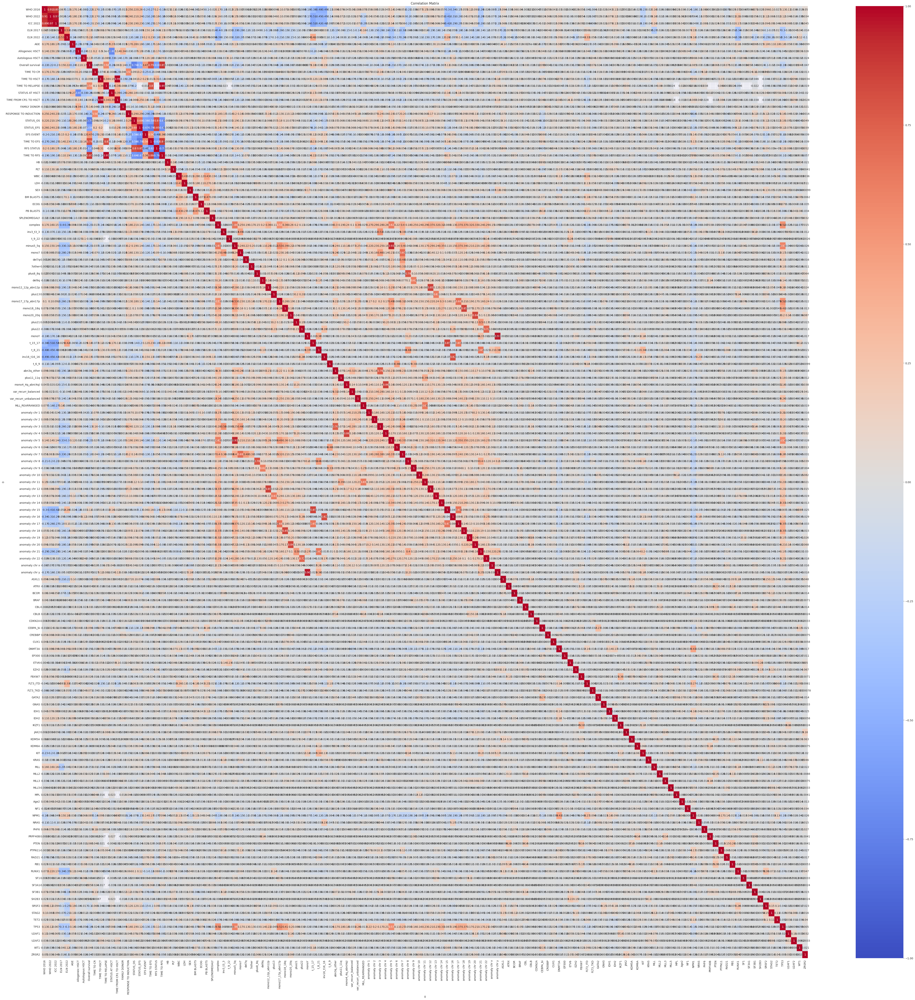

In [28]:
#CORRELATION MATRIX
fig = plt.figure(figsize=(65,65))
# Plot the correlation matrix
correlation_matrix = database_numeric.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

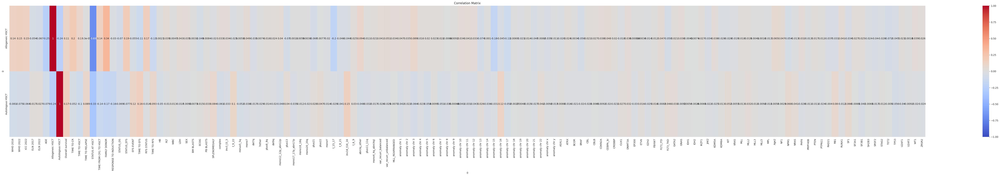

In [29]:
#CORRELATION MATRIX FOR TREATMENTS
fig = plt.figure(figsize=(65,10))
sns.heatmap(correlation_matrix.loc[info_dict['treatments'],:], annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.tight_layout()
plt.show()

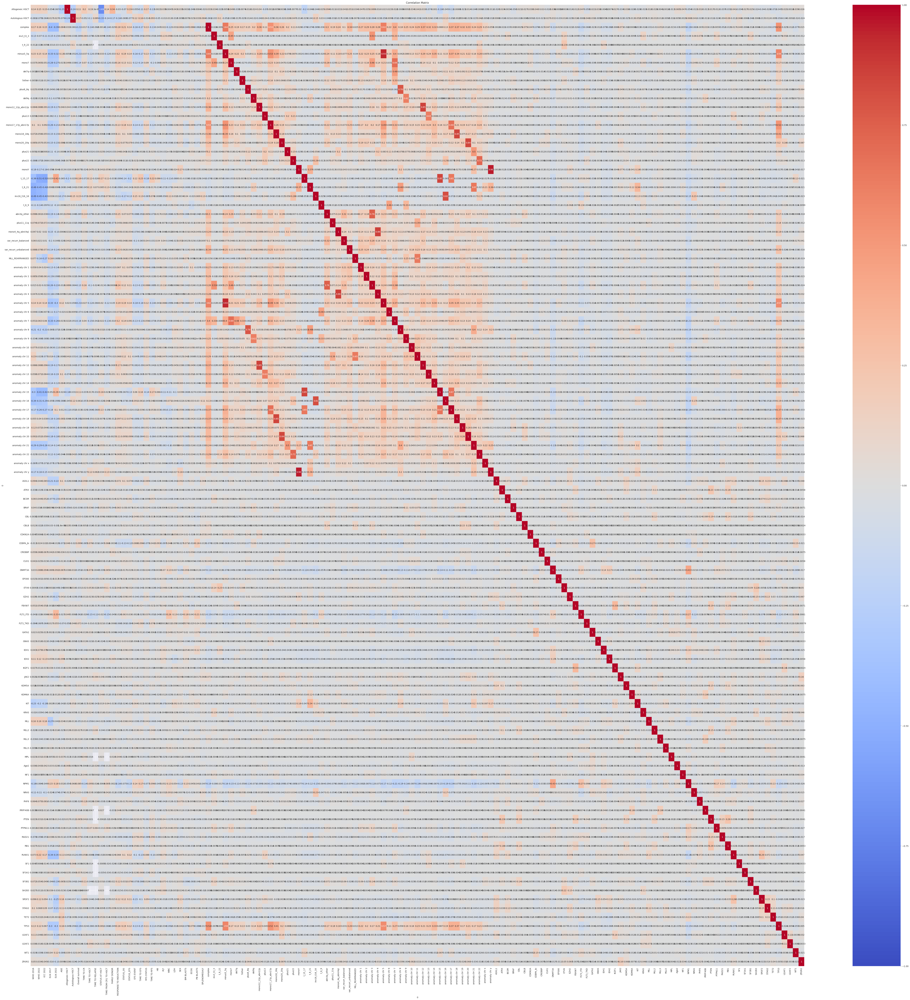

In [30]:
# CORRELATION MATRIX FOR GENETIC VARIABLES
fig = plt.figure(figsize=(65,65))
sns.heatmap(correlation_matrix.loc[info_dict['genetic_vars'],:], annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.tight_layout()
plt.show()

['WHO 2022', 'ICC 2022', 'ELN 2022', 'TIME TO RELAPSE', 'STATUS AT HSCT', 'TIME FROM CR1 TO HSCT', 'RESPONSE TO INDUCTION', 'STATUS_OS', 'STATUS_EFS', 'EFS EVENT', 'TIME TO EFS', 'RFS STATUS', 'TIME TO RFS', 'minus5_5q', 'mono17_17p_abn17p', 't_15_17', 'anomaly chr 3', 'anomaly chr 4', 'anomaly chr 5', 'anomaly chr 7', 'anomaly chr 8', 'anomaly chr 9', 'anomaly chr 11', 'anomaly chr 12', 'anomaly chr 13', 'anomaly chr 15', 'anomaly chr 16', 'anomaly chr 17', 'anomaly chr 18', 'anomaly chr 20', 'anomaly chr 21', 'anomaly chr 22', 'anomaly chr y', 'TP53']


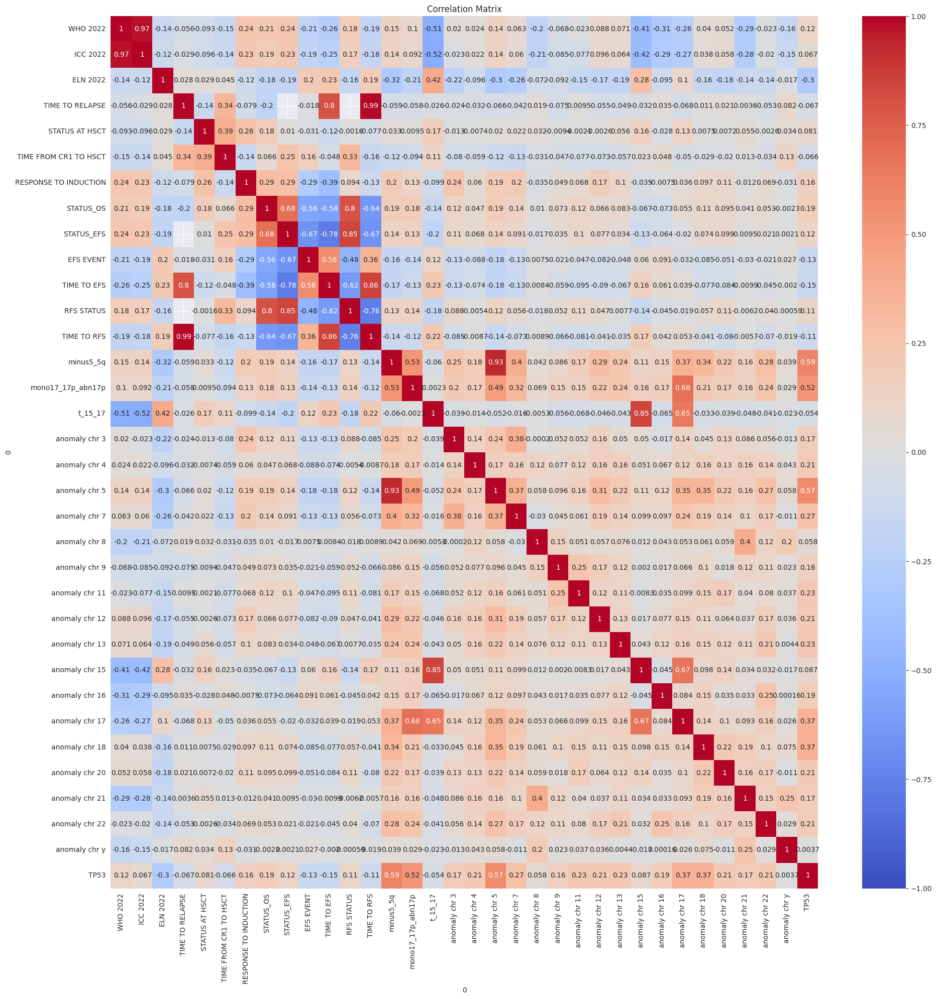

In [31]:
# get the list of the greatest correlations and plot only those
# get the upper triangle of the correlation matrix
upper = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))
# find the greatest correlations
greatest_corr = [column for column in upper.columns if any(abs(upper[column]) > 0.5)]
print(greatest_corr)

# plot the greatest correlations
fig = plt.figure(figsize=(20,20))
sns.heatmap(correlation_matrix.loc[greatest_corr,greatest_corr], annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.tight_layout()
plt.show()


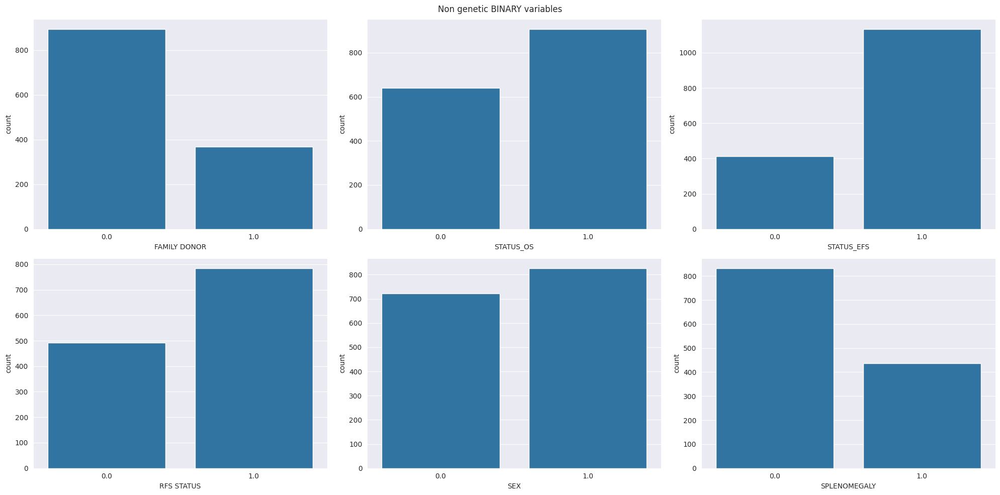

In [32]:
# Bar plots of binary variables
#first non genetic
fig, axs = plt.subplots(2, 3, figsize=(20, 10))
cont_i = 0
for col in info_dict['binary_nongenetic_vars']:
    sns.countplot(x=col, data=database_numeric, ax=axs[cont_i // 3, cont_i % 3])
    cont_i += 1
fig.suptitle('Non genetic BINARY variables')
plt.tight_layout()
plt.show()

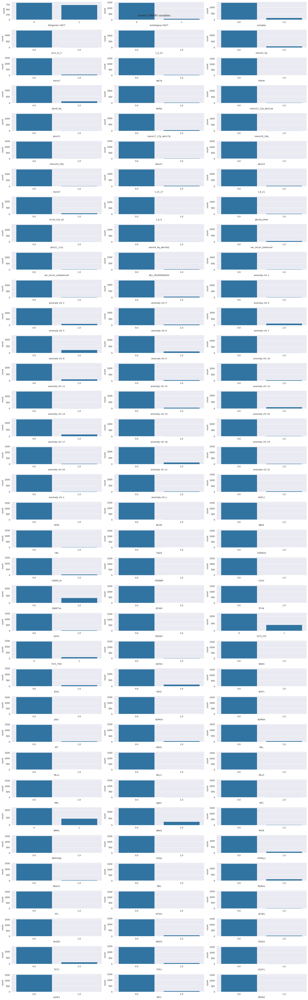

In [33]:
fig, axs = plt.subplots(info_dict['number_gens'] // 3, 3, figsize=(20, 65))
cont_i = 0
for col in info_dict['genetic_vars']:
    sns.countplot(x=col, data=database_numeric, ax=axs[cont_i // 3, cont_i % 3])
    cont_i += 1
fig.suptitle('Genetic BINARY variables')
plt.tight_layout()
plt.show()

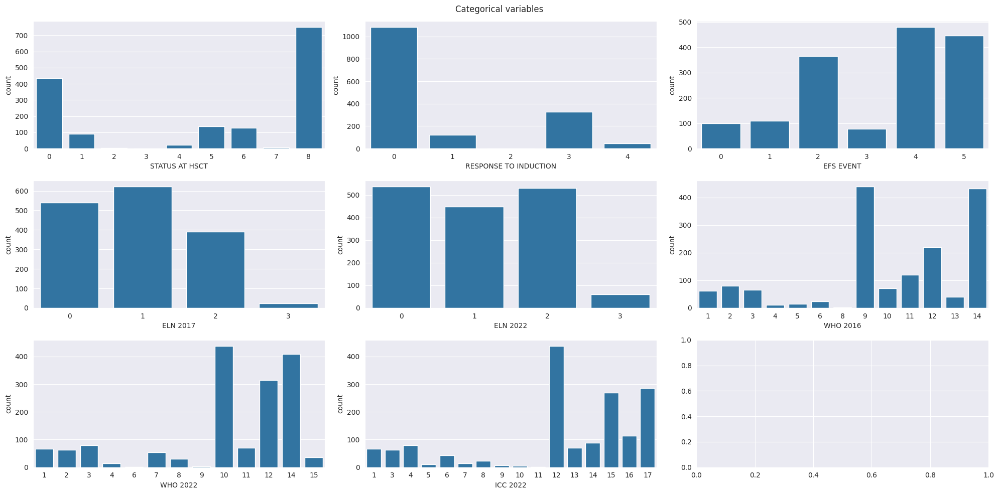

In [34]:

fig, axs = plt.subplots(info_dict['number_cat'] // 3 + 1, 3, figsize=(20, 10))
cont_i = 0
for col in info_dict['all_cat']:
    sns.countplot(x=col, data=database_numeric, ax=axs[cont_i // 3, cont_i % 3])
    cont_i += 1
fig.suptitle('Categorical variables')
plt.tight_layout()
plt.show()

In [35]:
def plot_3chart(df, feature):
    import matplotlib.gridspec as gridspec
    from matplotlib.ticker import MaxNLocator
    from scipy.stats import norm
    from scipy import stats

    # Creating a customized chart. and giving in figsize and everything.

    fig = plt.figure(constrained_layout=True, figsize=(12, 8))

    # Creating a grid of 3 cols and 3 rows.

    grid = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)

    # Customizing the histogram grid.

    ax1 = fig.add_subplot(grid[0, :2])

    # Set the title.

    ax1.set_title('Histogram')

    # Plot the histogram.

    sns.distplot(df.loc[:, feature],
                 hist=True,
                 kde=True,
                 fit=norm,
                 ax=ax1,
                 color='#e74c3c')
    ax1.legend(labels=['Normal', 'Actual'])

    # Customizing the QQ_plot.

    ax2 = fig.add_subplot(grid[1, :2])

    # Set the title.

    ax2.set_title('Probability Plot')

    # Plotting the QQ_Plot.

    stats.probplot(df.loc[:, feature].fillna(np.mean(df.loc[:, feature])),
                   plot=ax2)
    ax2.get_lines()[0].set_markerfacecolor('#e74c3c')
    ax2.get_lines()[0].set_markersize(12.0)

    # Customizing the Box Plot.

    ax3 = fig.add_subplot(grid[:, 2])

    # Set title.

    ax3.set_title('Box Plot')

    # Plotting the box plot.

    sns.boxplot(df.loc[:, feature], orient='v', ax=ax3, color='#e74c3c')
    ax3.yaxis.set_major_locator(MaxNLocator(nbins=24))

    plt.suptitle(f'{feature}', fontsize=24)

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


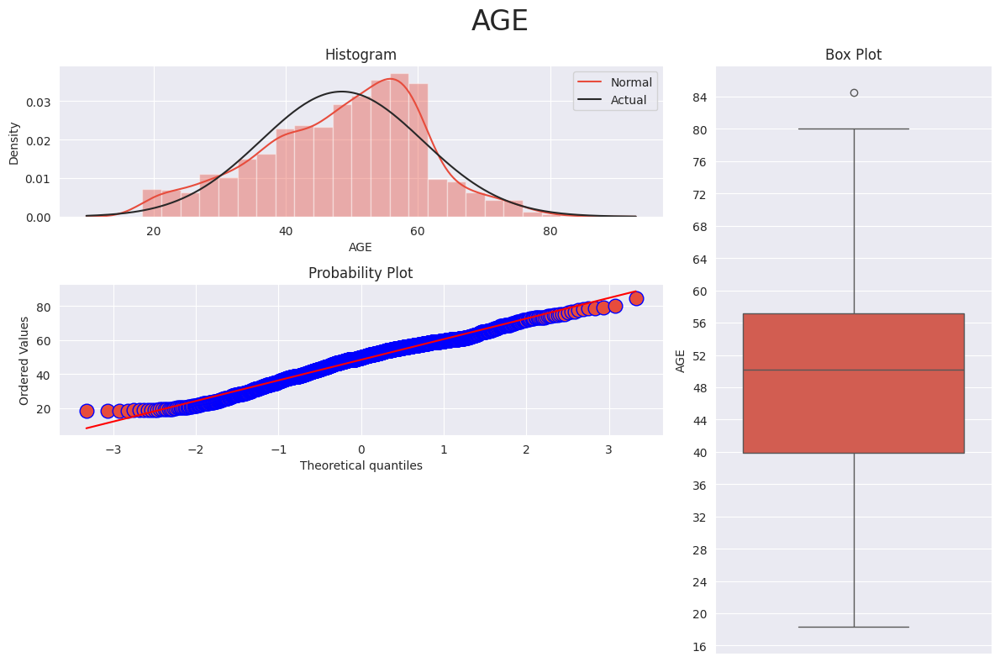

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


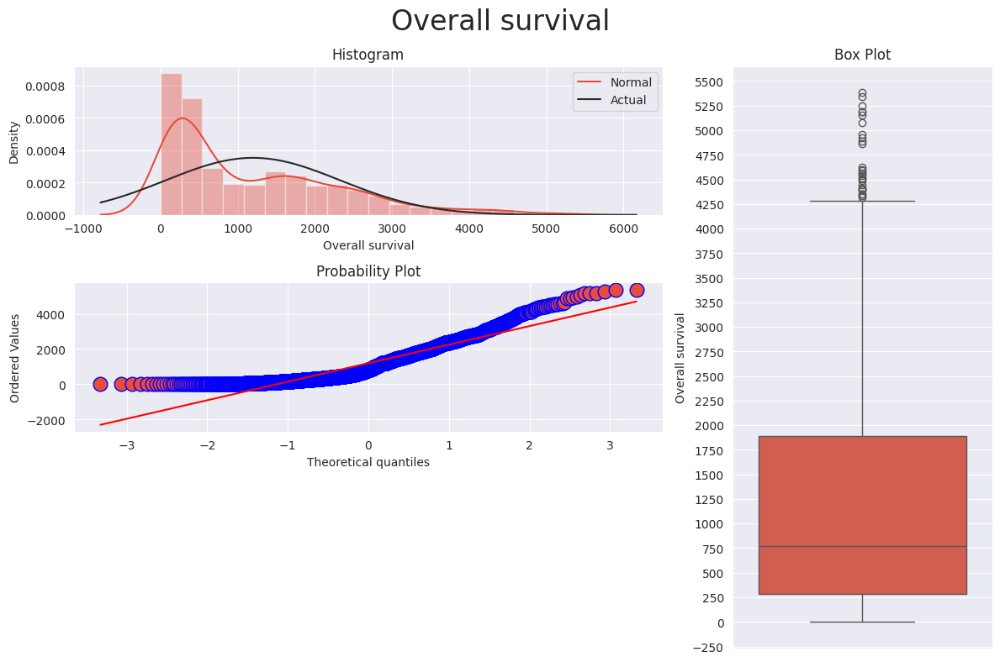

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


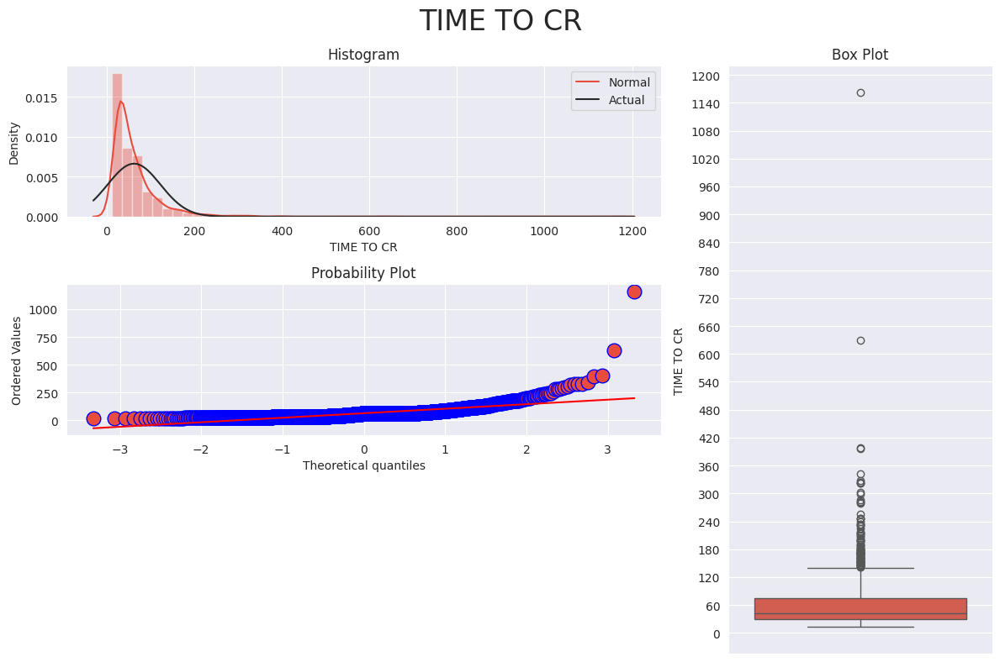

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


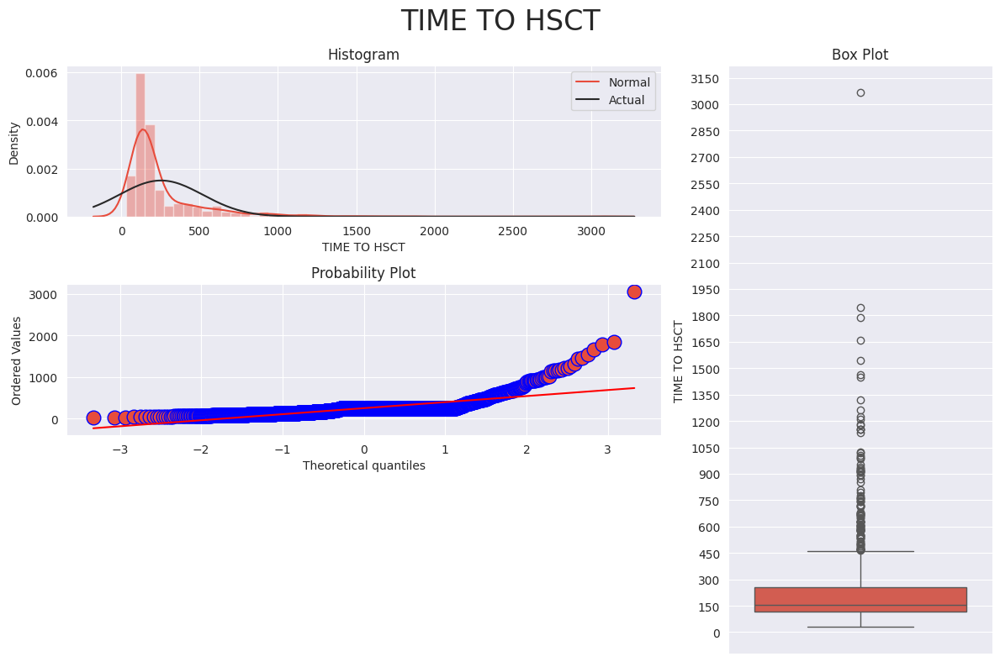

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


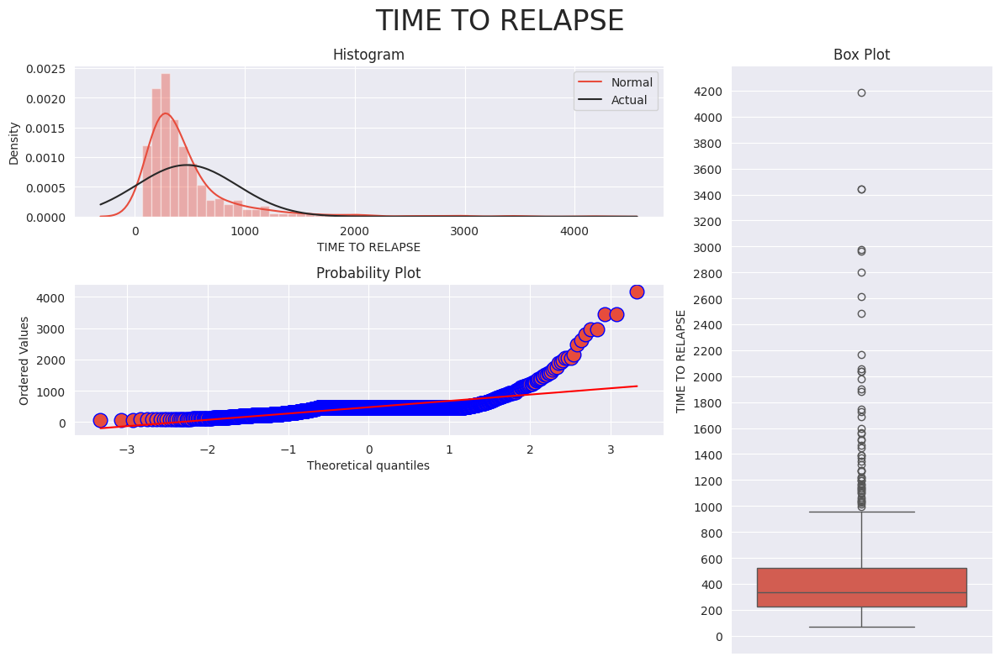

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


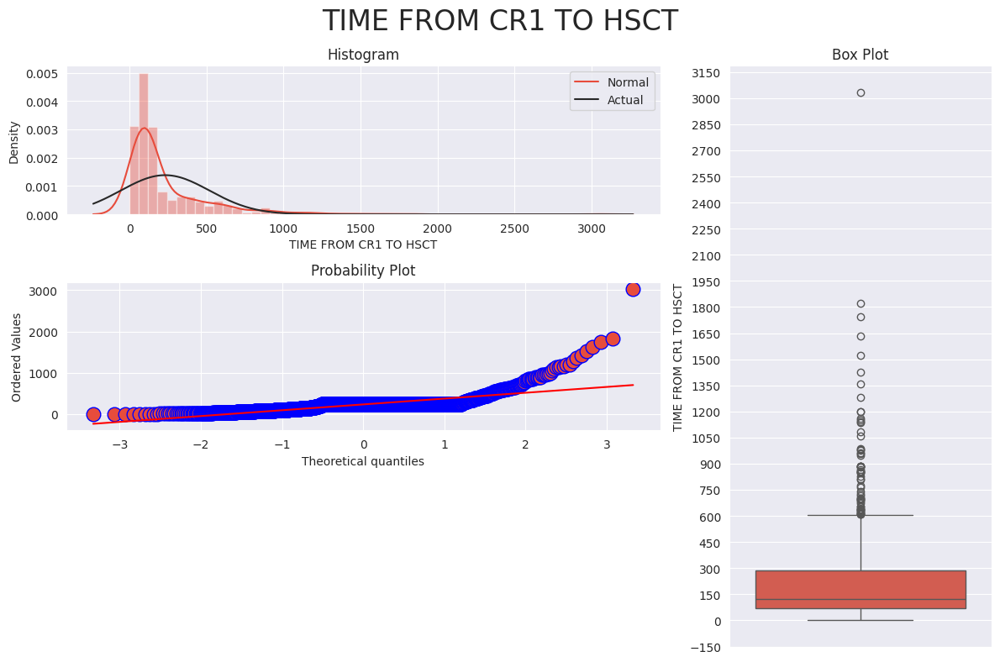

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


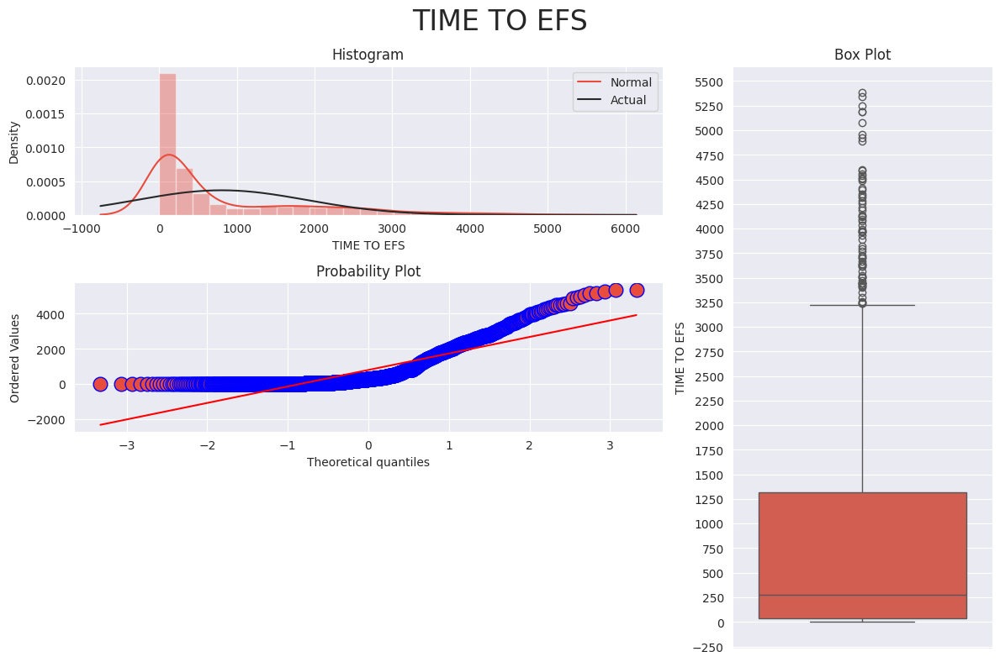

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


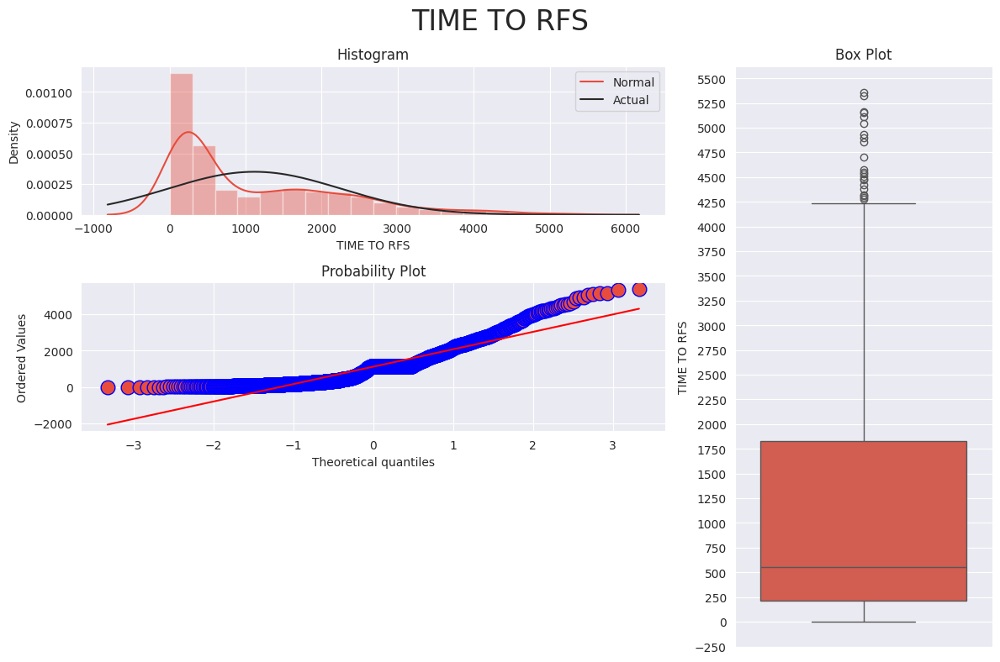

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


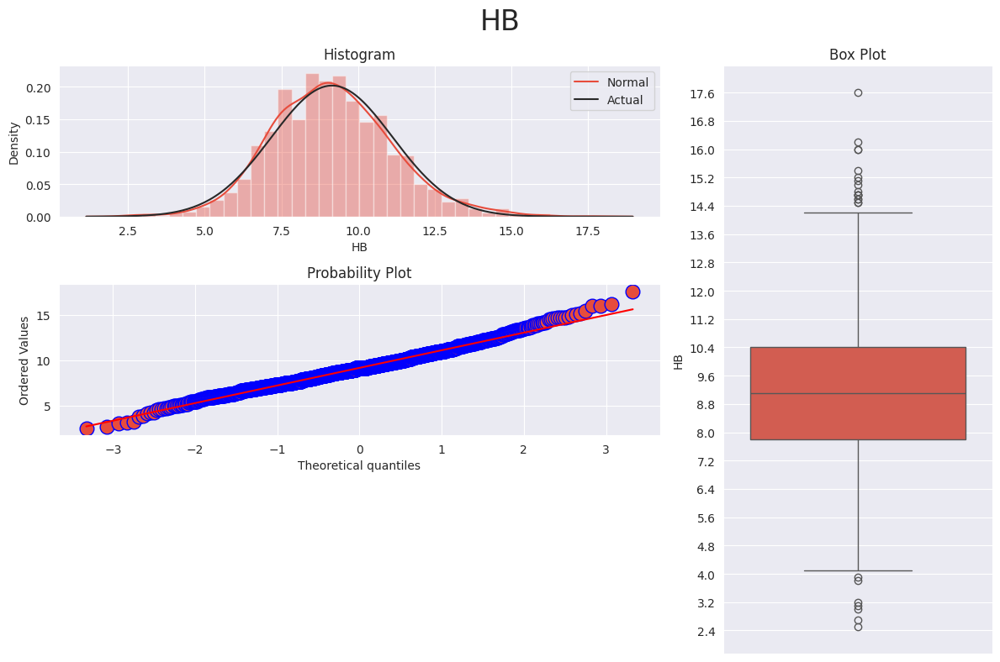

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


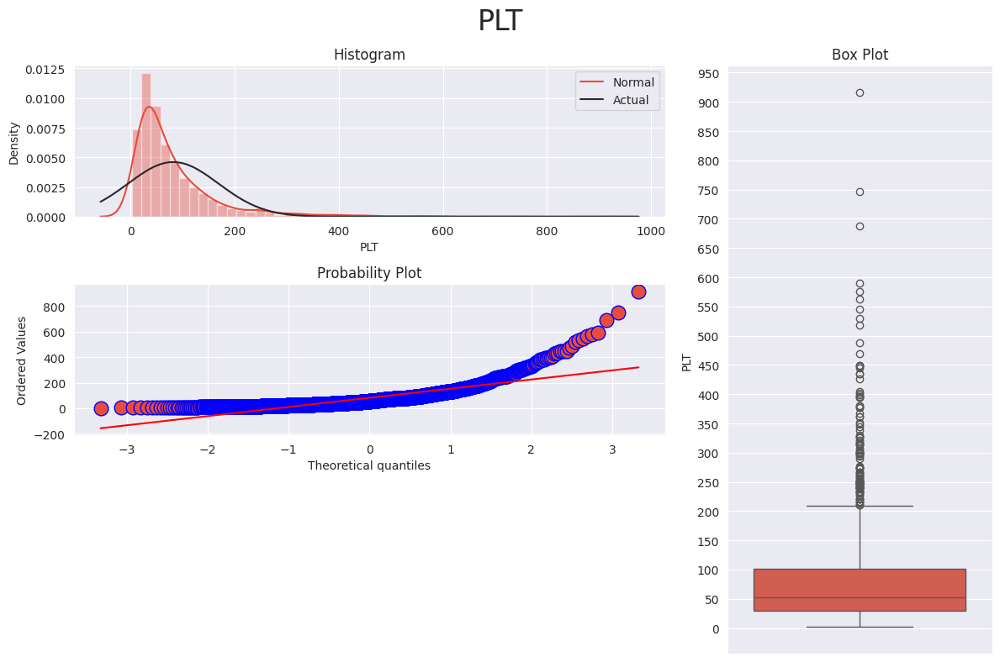

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


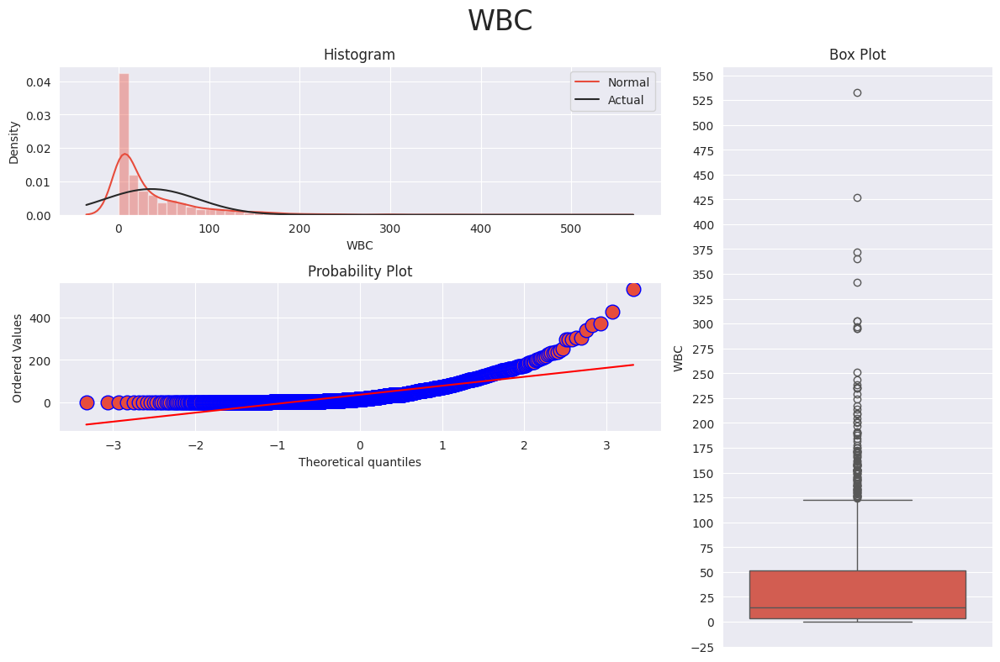

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


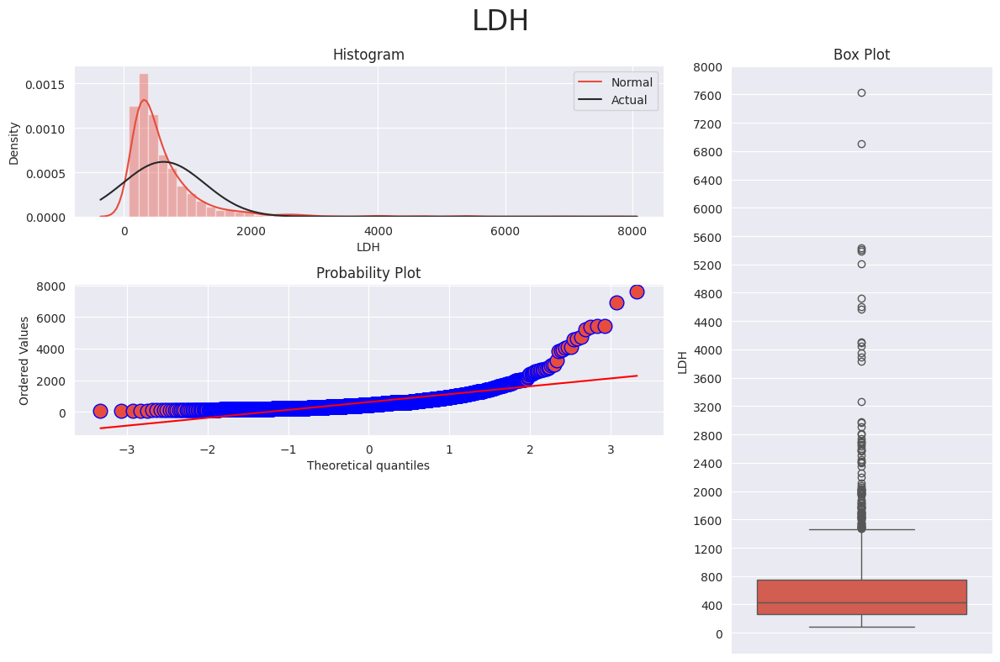

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


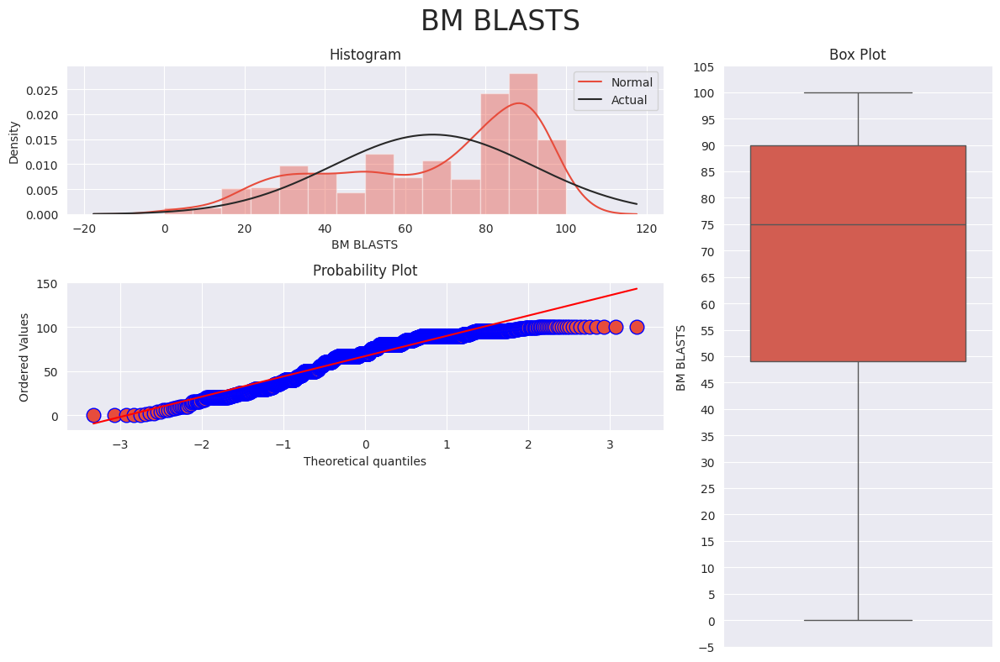

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


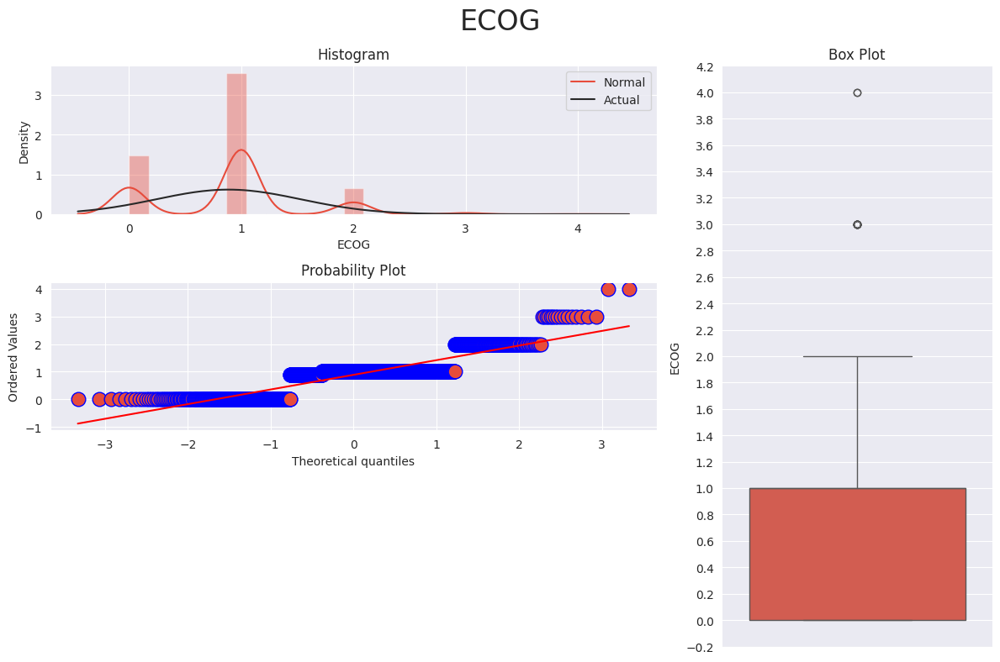

/tmp/ipykernel_93682/2296337523.py:25: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.loc[:, feature],
/tmp/ipykernel_93682/1237095383.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


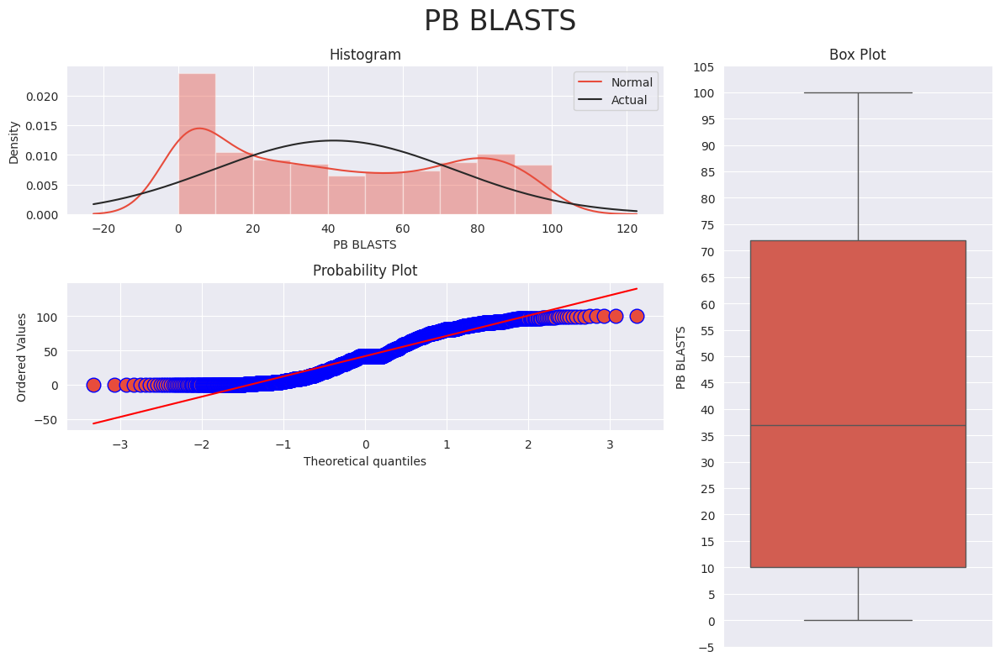

In [36]:

for col in info_dict['continuous_vars']:
    plot_3chart(database_numeric, col)
    plt.tight_layout()
    plt.show()

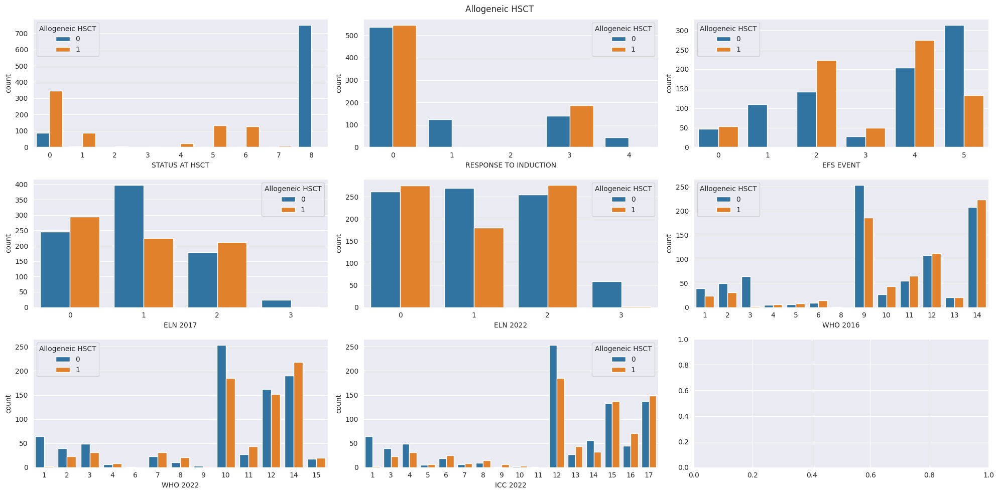

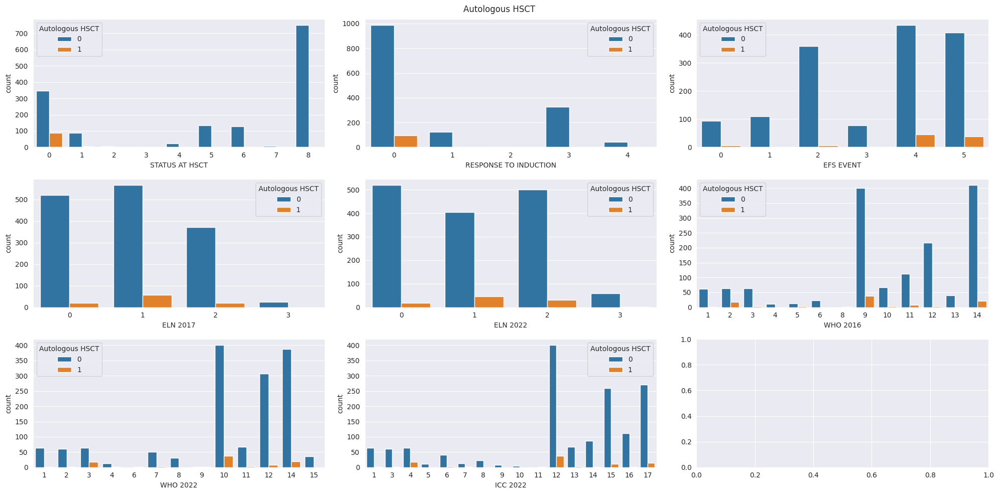

In [37]:
# Check overlaping of treatments with other variables
#for categorical variables
for treatment in info_dict['treatments']:
    fig, axs = plt.subplots(3, 3, figsize=(20, 10))
    cont_i = 0
    for col in info_dict['all_cat']:
        sns.countplot(x=col, hue=treatment, data=database_numeric, ax=axs[cont_i // 3, cont_i % 3])
        cont_i += 1
    fig.suptitle(treatment)
    plt.tight_layout()
    plt.show()

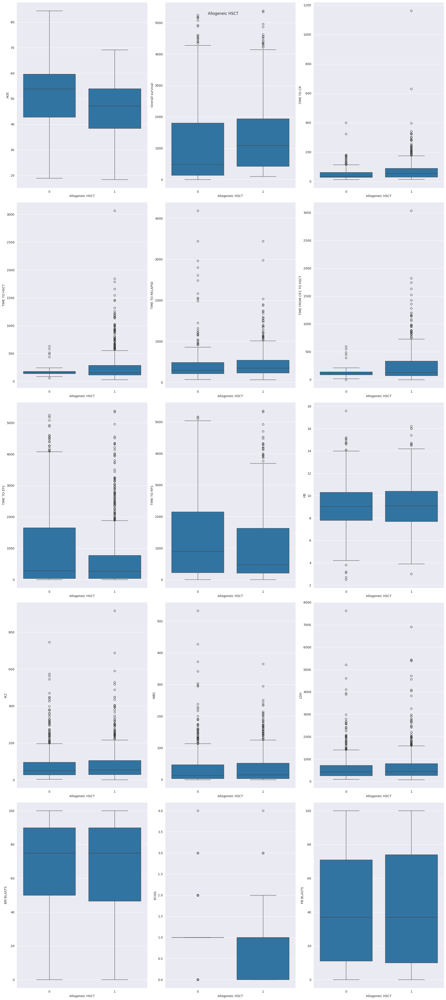

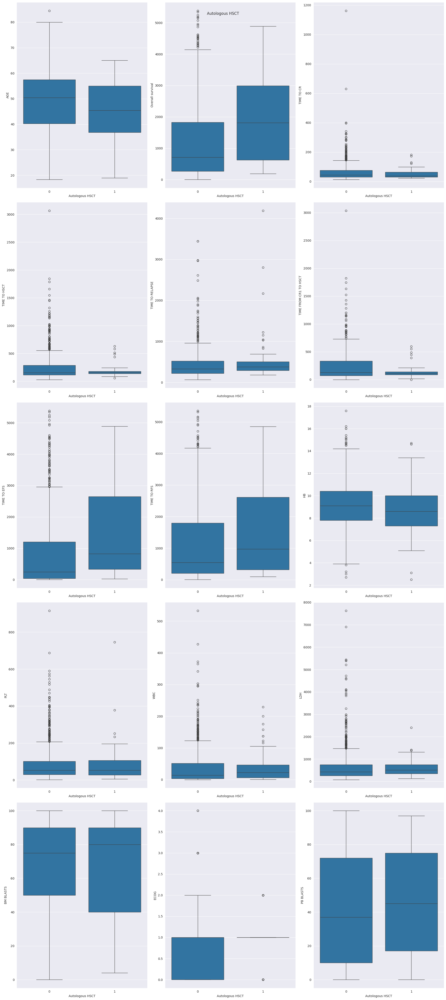

In [38]:
# for continuous variables
number_cont = len(info_dict['continuous_vars'])
for treatment in info_dict['treatments']:
    fig, axs = plt.subplots(number_cont // 3, 3, figsize=(20, 45))
    cont_i = 0
    for col in info_dict['continuous_vars']:
        sns.boxplot(x=treatment, y=col, data=database_numeric, ax=axs[cont_i // 3, cont_i % 3])
        cont_i += 1
    fig.suptitle(treatment)
    plt.tight_layout()
    plt.show()

In [39]:
# are treatment excluyent?
# return the count of each combination of treatments
treatments_df = database_numeric.loc[:, info_dict['treatments']]
treatments_df['count'] = 1
treatments_df = treatments_df.groupby(info_dict['treatments']).count()
print(treatments_df)

0                                count
Allogeneic HSCT Autologous HSCT       
0               0                  749
                1                   95
1               0                  733


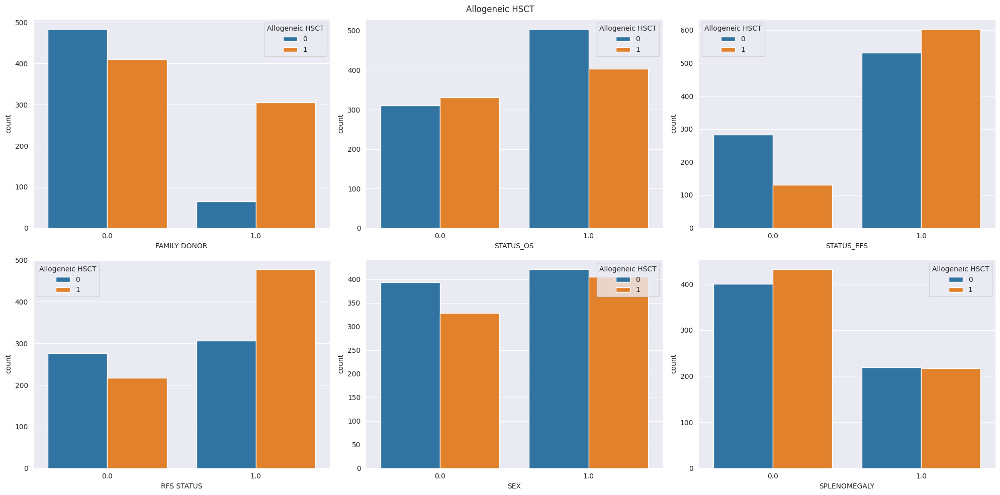

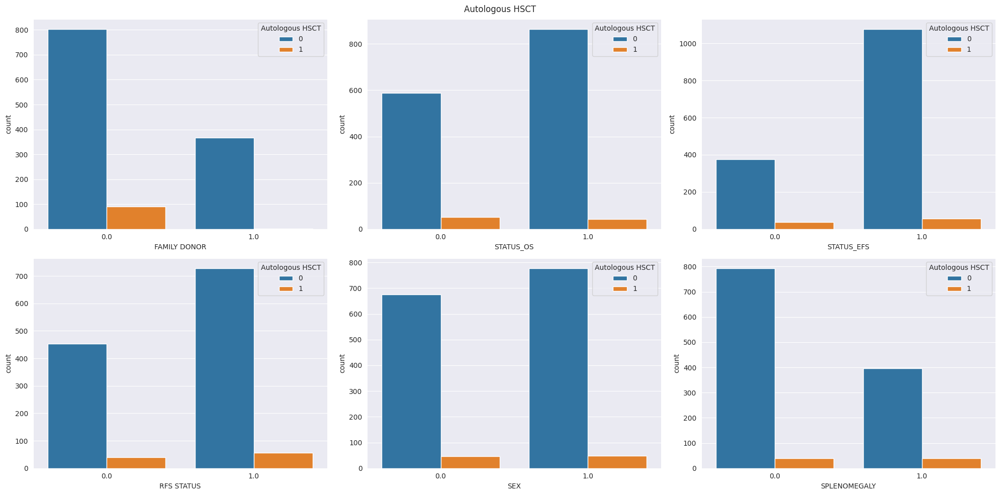

In [40]:
# for binary variables
# nongenetic
for treatment in info_dict['treatments']:
    fig, axs = plt.subplots(info_dict['number_binary_nongenetic']//3, 3, figsize=(20, 10))
    cont_i = 0
    for col in info_dict['binary_nongenetic_vars']:
        sns.countplot(x=col, hue=treatment, data=database_numeric, ax=axs[cont_i // 3, cont_i % 3])
        cont_i += 1
    fig.suptitle(treatment)
    plt.tight_layout()
    plt.show()

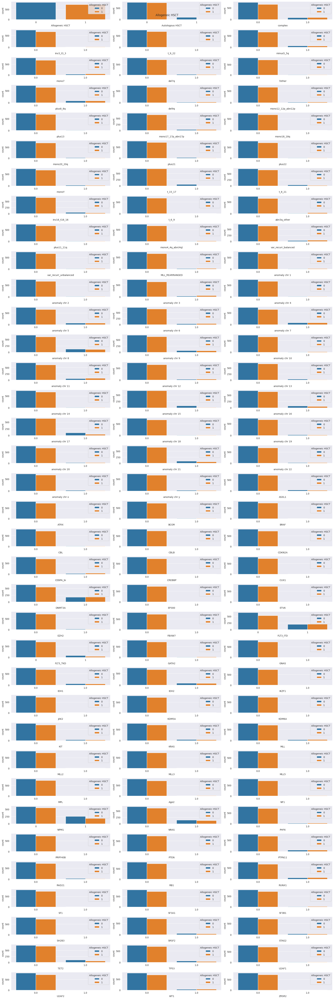

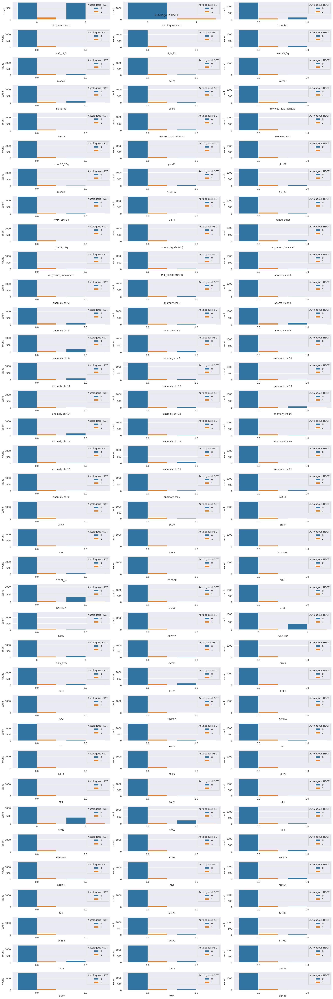

In [41]:

# genetic
for treatment in info_dict['treatments']:
    fig, axs = plt.subplots(info_dict['number_gens']//3, 3, figsize=(20, 60))
    cont_i = 0
    for col in info_dict['genetic_vars']:
        sns.countplot(x=col, hue=treatment, data=database_numeric, ax=axs[cont_i // 3, cont_i % 3])
        cont_i += 1
    fig.suptitle(treatment)
    plt.tight_layout()
    plt.show()

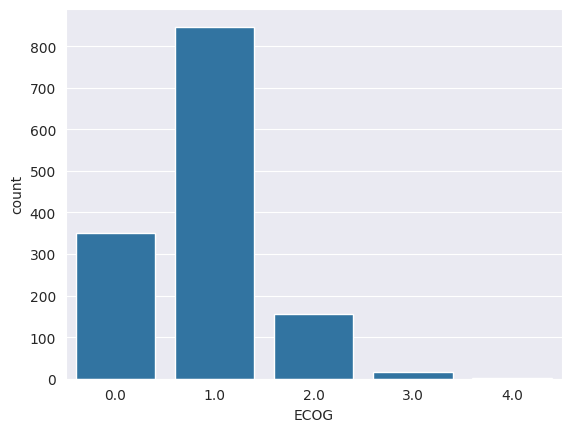

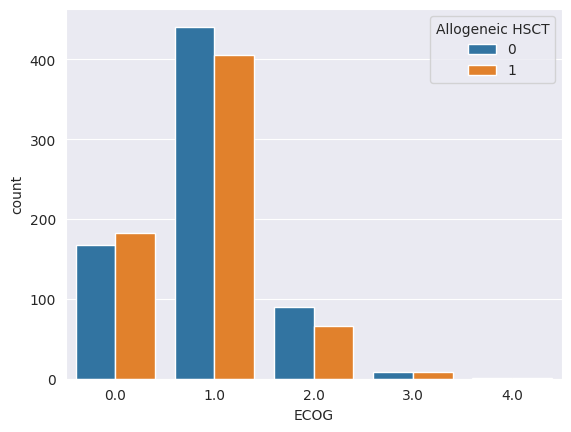

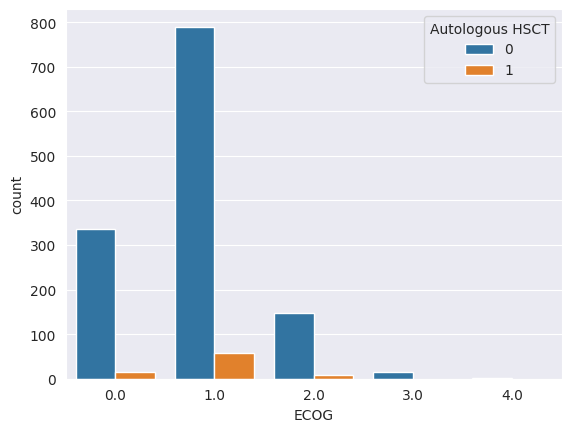

In [42]:
# focus con 'ECOG' covariate
# ECOG is a covariate that is used to measure the general well-being of a patient and is used to determine the
# treatment to be applied. It is a categorical variable with 6 possible values: 0, 1, 2, 3, 4, 5.

# check the distribution of ECOG
sns.countplot(x='ECOG', data=database_numeric)
plt.show()

# check the distribution of ECOG for each treatment
for treatment in info_dict['treatments']:
    sns.countplot(x='ECOG', hue=treatment, data=database_numeric)
    plt.show()


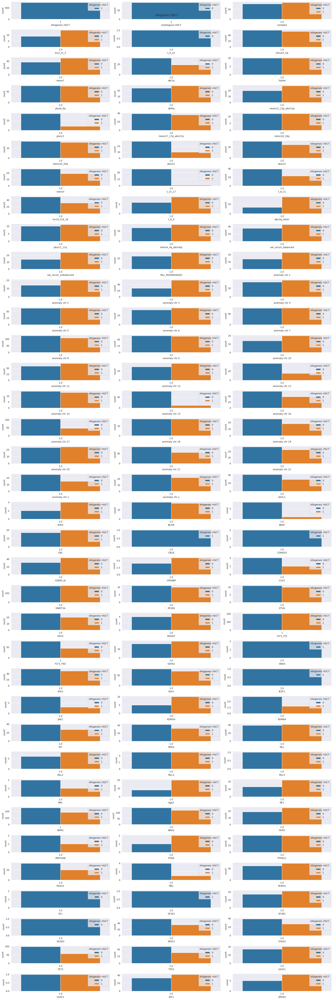

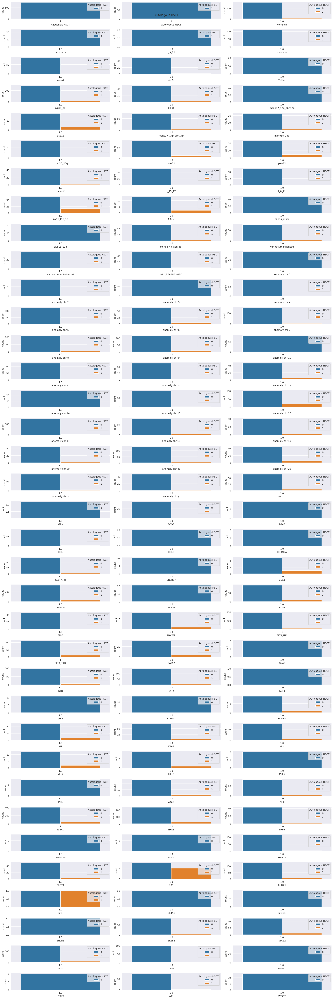

In [43]:
#PLOT, FOR genetic variables, the count of treated / untreated for each treatment only for true values of the variable
# (for example, for the variable 'KRAS' plot the count of treated / untreated for each treatment only for patients
# with 'KRAS' = 1)
# for genetic variables
for treatment in info_dict['treatments']:
    fig, axs = plt.subplots(info_dict['number_gens']//3, 3, figsize=(20, 60))
    cont_i = 0
    for col in info_dict['genetic_vars']:
        sns.countplot(x=col, hue=treatment, data=database_numeric.loc[database_numeric[col] == 1], ax=axs[cont_i // 3, cont_i % 3])
        cont_i += 1
    fig.suptitle(treatment)
    plt.tight_layout()
    plt.show()